# Clustering of NR Clean data
* continuing from 2024-11-08_Clean-data-integration.jpynb
* clustering, visualising and annotating of Nikita clean data (containing just macs and DCs)

# Set up workspace:

In [1]:
#load packages I need
import os
import tools
import scanpy as sc
import pandas as pd
import dandelion as ddl
from tqdm import tqdm
import matplotlib.pyplot as plt
import scanpy.external as sce
from matplotlib.pyplot import rc_context

In [2]:
#show current directory 
os.getcwd()
os.chdir('/scratch/user/s4436039/scdata/Python_Integration_Sep')
os.getcwd()

'/scratch/user/s4436039/scdata/Python_Integration_Sep'

Print software versions:

In [3]:
sc.logging.print_header()

scanpy==1.10.2 anndata==0.10.8 umap==0.5.6 numpy==1.26.4 scipy==1.14.0 pandas==2.2.2 scikit-learn==1.5.0 statsmodels==0.14.2 igraph==0.11.5 pynndescent==0.5.12


In [4]:
ddl.logging.print_header()

dandelion==0.3.8 pandas==2.2.2 numpy==1.26.4 matplotlib==3.9.2 networkx==3.3 scipy==1.14.0


Set plotting parameters

In [5]:
sc.settings.set_figure_params(dpi=80, facecolor="white")

In [ ]:
# read in data
data = sc.read_h5ad('NRclean_post-int.h5ad')

In [50]:
data

AnnData object with n_obs × n_vars = 498382 × 1268
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden', 'celltype', 'leiden_DC', 'leiden_DC_v2', 'exclude_annots', 'leiden_M', 'Technology'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'c

# Add in metadata column that has broader cancer_subtypes 
* (ie. grouping all the breast cancers together)

In [51]:
#make a column new to store broad cancer type
data.obs["cancer_type_broad"] = data.obs["cancer_subtype"]

In [52]:
unique_values = data.obs['cancer_type_broad'].unique().tolist()
print(unique_values)

['Acral Melanoma', 'Melanoma', 'TNBC', 'HNSCC', 'NSCLC', 'NA', 'HER2 Breast Cancer', 'ER Breast Cancer', 'HGSOC', 'Breast DCIS', 'Breast IDC', 'BRCA1 TNBC', 'PDAC', 'CRC', 'Breast Cancer', 'GBM', 'GAC', 'HCC', 'iCCA', 'NPC']


In [53]:
#make a copy of the data containing just the breast cancers 
breast = data[data.obs["cancer_subtype"].isin(["BRCA1 TNBC", "Breast Cancer", "Breast DCIS", "Breast IDC","ER Breast Cancer","HER2 Breast Cancer","TNBC"])]
#set all those in breast to Breast Cancer
breast.obs["cancer_type_broad"] = "Breast Cancer"

/scratch/temp/11499052/ipykernel_3824376/598791162.py:4: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


In [54]:
#update the original object
data.obs["cancer_type_broad"].update(breast.obs["cancer_type_broad"]) 

/scratch/temp/11499052/ipykernel_3824376/3103835579.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.




In [55]:
unique_values = data.obs['cancer_type_broad'].unique().tolist()
print(unique_values)

['Acral Melanoma', 'Melanoma', 'Breast Cancer', 'HNSCC', 'NSCLC', 'NA', 'HGSOC', 'PDAC', 'CRC', 'GBM', 'GAC', 'HCC', 'iCCA', 'NPC']


In [56]:
unique_values = data.obs['cancer_subtype'].unique().tolist()
print(unique_values)

['Acral Melanoma', 'Melanoma', 'TNBC', 'HNSCC', 'NSCLC', 'NA', 'HER2 Breast Cancer', 'ER Breast Cancer', 'HGSOC', 'Breast DCIS', 'Breast IDC', 'BRCA1 TNBC', 'PDAC', 'CRC', 'Breast Cancer', 'GBM', 'GAC', 'HCC', 'iCCA', 'NPC']


In [57]:
#export updated object
data.write_h5ad("NRclean_clustered.h5ad", compression="gzip")

In [58]:
data

AnnData object with n_obs × n_vars = 498382 × 1268
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden', 'celltype', 'leiden_DC', 'leiden_DC_v2', 'exclude_annots', 'leiden_M', 'Technology', 'cancer_type_broad'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    var

# Perform clustering (1hr):
* Choosing excessively high resolution as want to break in to lots of clusters and then can score them all on gene sets and regroup clusters

### Clustering step was done by submitting a job. 

* Bashscript is named: _NR_bashscript-leiden2.sh
* python script named: _NR-script-leiden2.py

Ran with `sbatch _NR_bashscript-leiden2.sh`

Bashscript: 
``` bash
#!/bin/bash
#SBATCH --nodes=1
#SBATCH --ntasks-per-node=1
#SBATCH --cpus-per-task=64
#SBATCH --mem=200G
#SBATCH --job-name=NR-clean-leiden08
#SBATCH --time=4:00:00
#SBATCH --partition=general
#SBATCH --account=a_kelvin_tuong
#SBATCH -o NR-clean-leiden08.output
#SBATCH -e NR-clean-leiden08.error

# export JAVA_CMD=/home/uqztuong/miniforge3/bin/java
source ~/.bashrc
mamba activate env
python3 _NR-script-leiden2.py
```

Python script: 
``` python
import os
import tools
import scanpy as sc
import pandas as pd
import dandelion as ddl
from tqdm import tqdm
import matplotlib.pyplot as plt
import scanpy.external as sce

os.chdir('/scratch/user/s4436039/scdata/Python_Integration_Sep')

data = sc.read_h5ad("/scratch/user/s4436039/scdata/Python_Integration_Sep/NRclean_clustered.h5ad")

sc.tl.leiden(data, resolution=0.8, key_added='clean-leiden_0.8')

data.write_h5ad("/scratch/user/s4436039/scdata/Python_Integration_Sep/NRclean_clustered.h5ad", compression="gzip")
```

### took ~1hr

In [6]:
# read in data
data = sc.read_h5ad('NRclean_clustered.h5ad')

### Visualise clusters:

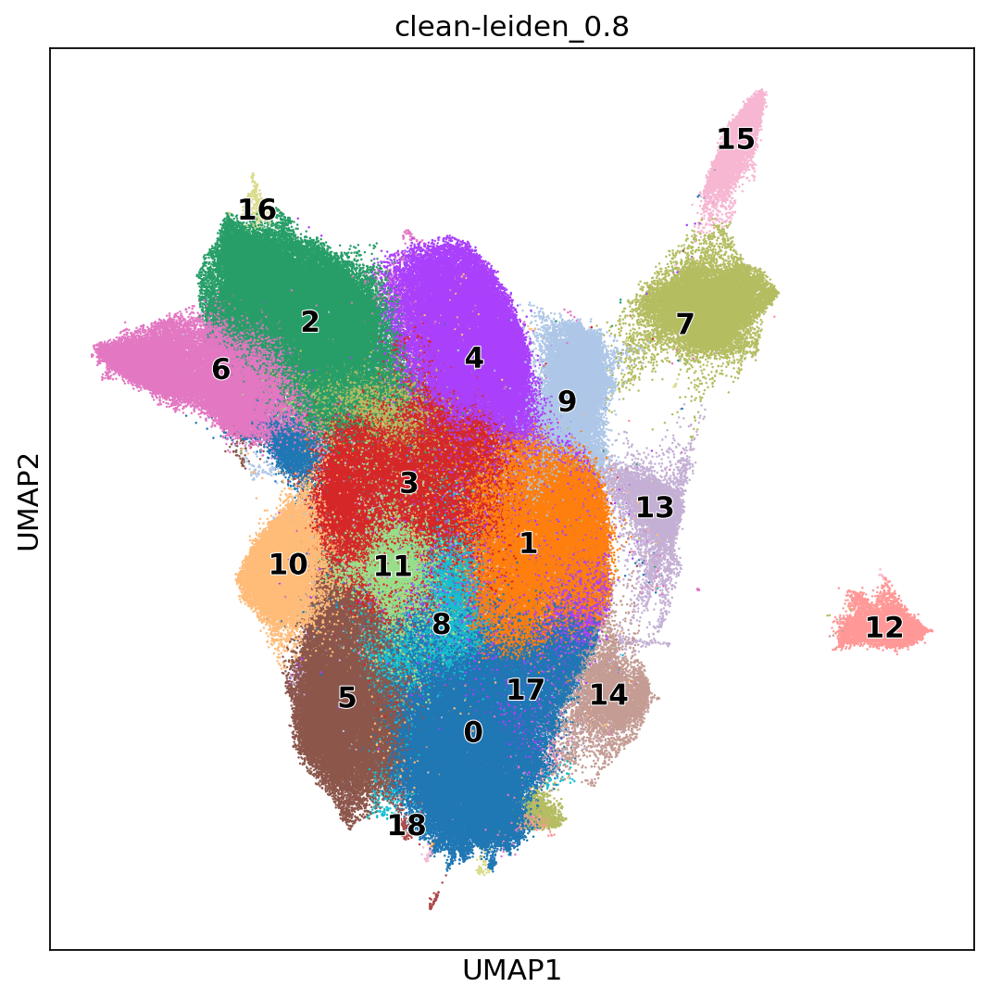

In [9]:
#plotting clusters
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color="clean-leiden_0.8", legend_loc="on data", legend_fontoutline=1, size=5)

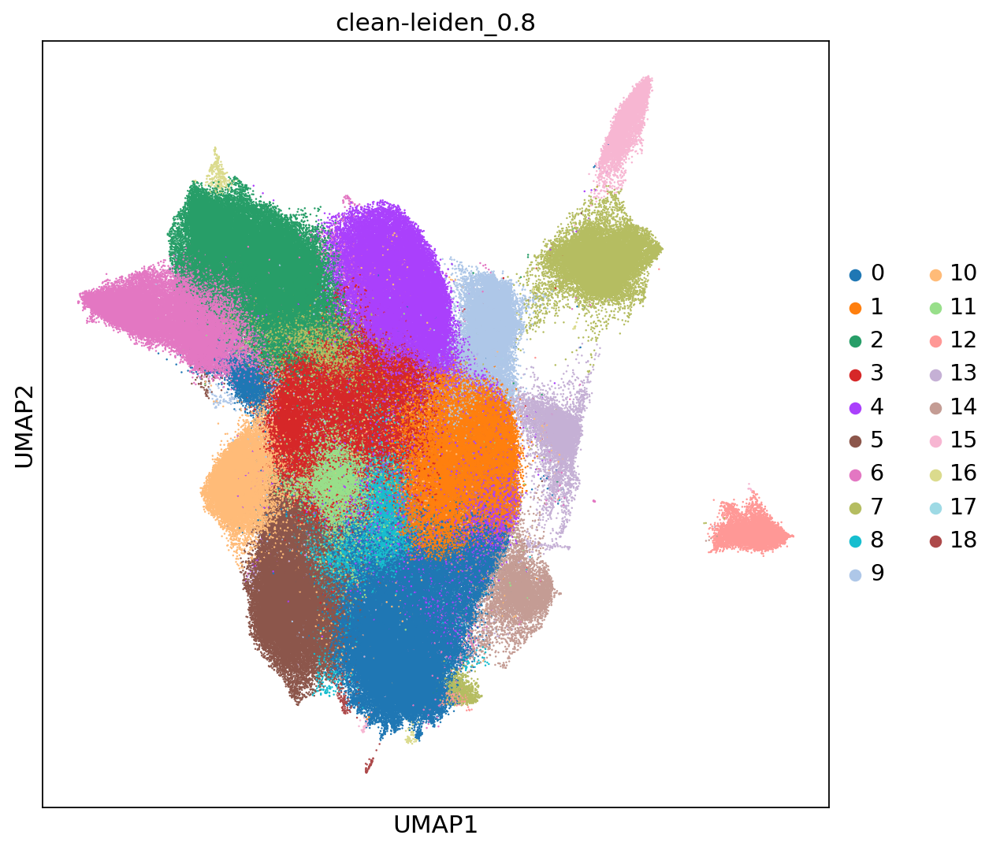

In [10]:
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color="clean-leiden_0.8", size=5)

### view each cluster seperately to see if any should be subclustered

In [11]:
#define function
def cluster_small_multiples(
    data_int, clust_key, size=5, frameon=False, legend_loc=None, **kwargs
):
    tmp = data_int.copy()

    for i, clust in enumerate(data_int.obs[clust_key].cat.categories):
        tmp.obs[clust] = data_int.obs[clust_key].isin([clust]).astype("category")
        tmp.uns[clust + "_colors"] = ["#d3d3d3", data_int.uns[clust_key + "_colors"][i]]

    sc.pl.umap(
        tmp,
        groups=tmp.obs[clust].cat.categories[1:].values,
        color=data_int.obs[clust_key].cat.categories.tolist(),
        size=size,
        frameon=frameon,
        legend_loc=legend_loc,
        **kwargs
    )

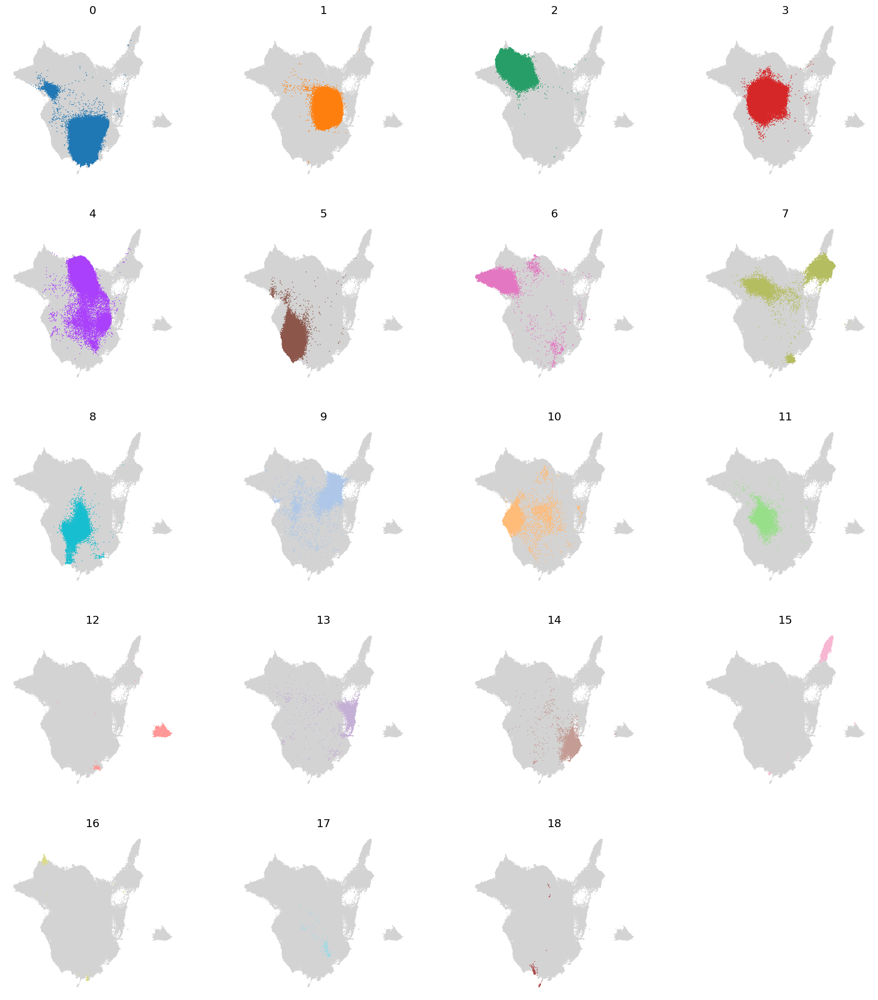

In [12]:
cluster_small_multiples(data, "clean-leiden_0.8")

### From this I want to subcluster clusters 0, 7, 12 further
* 0 doesn't split well
* 7 split in to 3 clusters

In [ ]:
#subcluster cluster 7
sc.tl.leiden(data, restrict_to=('clean-leiden_0.8', ['7']), resolution=0.1, key_added="clean-subcluster")

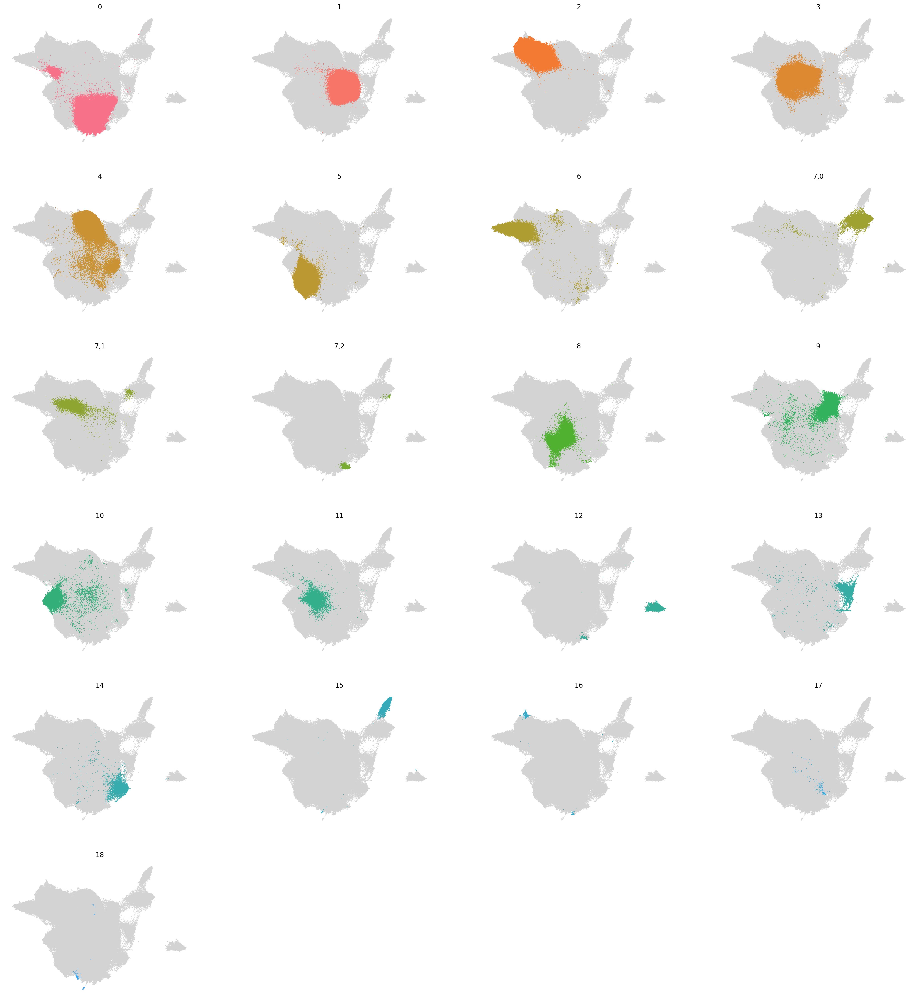

In [44]:
cluster_small_multiples(data, "clean-subcluster")

In [41]:
#subcluster cluster 12
sc.tl.leiden(data, restrict_to=('clean-subcluster', ['12']), resolution=0.2, key_added="clean-subcluster-v2")

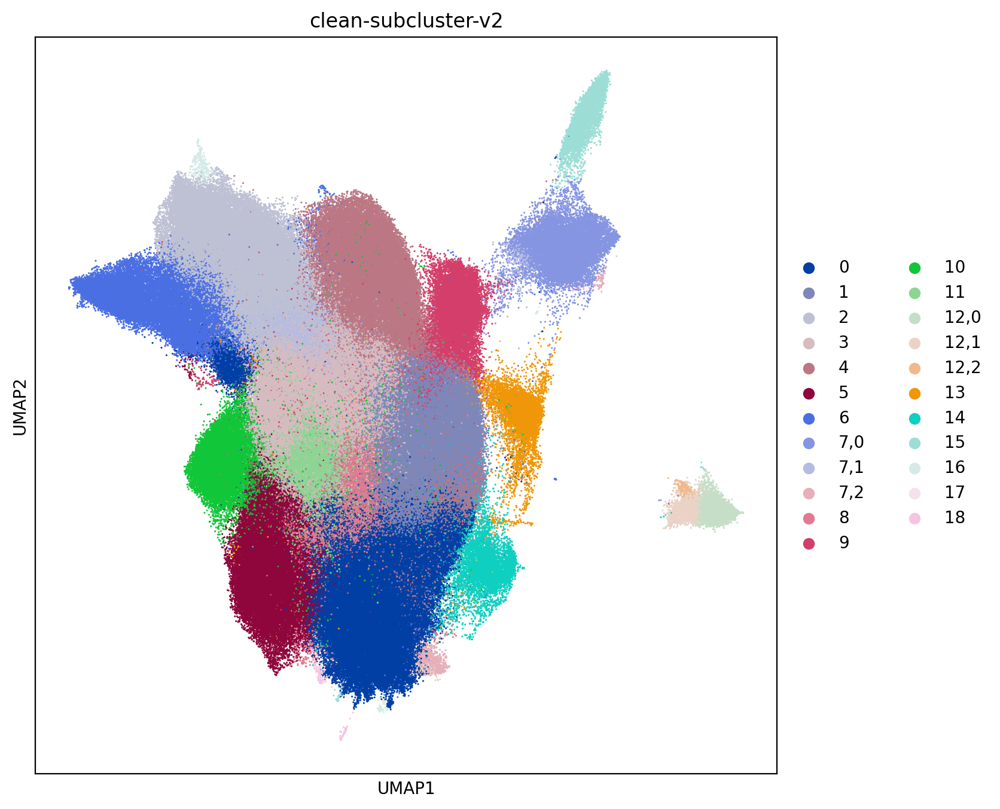

In [42]:
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color="clean-subcluster-v2", size=5)

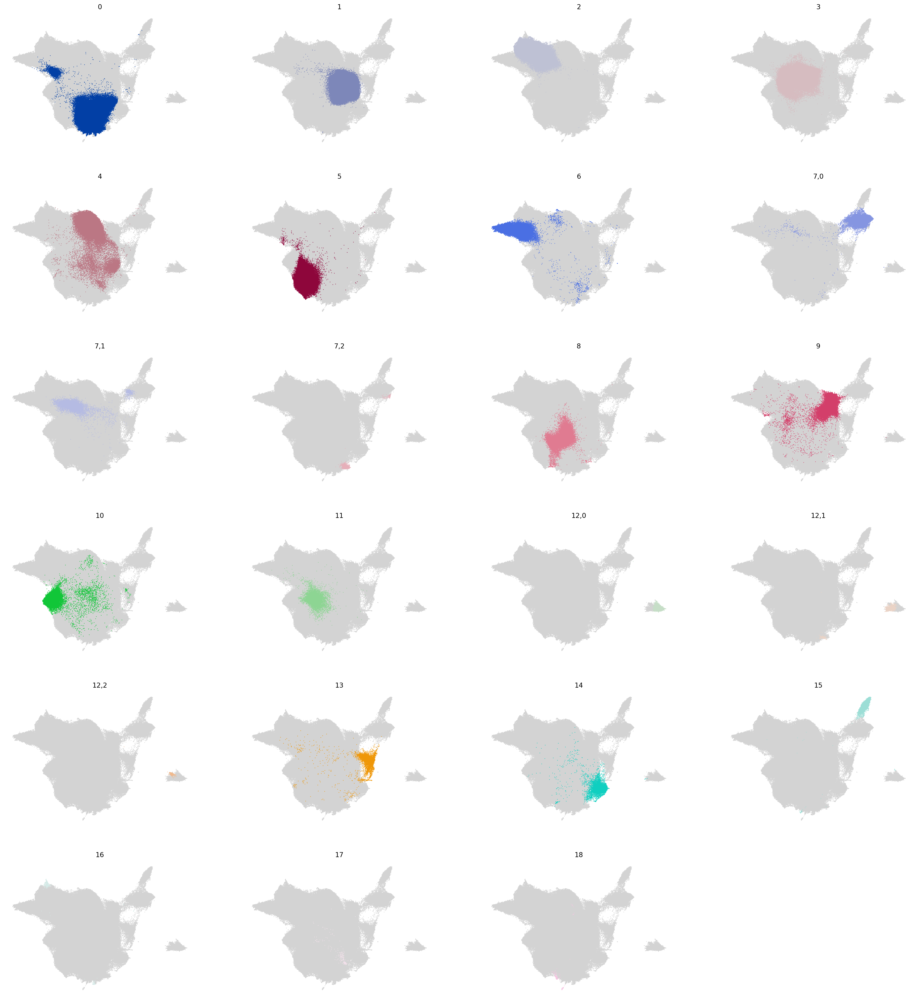

In [43]:
cluster_small_multiples(data, "clean-subcluster-v2")

# Score clusters by gene sets
* Now I have data split into small clusters to help with annotations score all clusters by my various gene sets

In [ ]:
#define DC subset gene sets from Villani et al 
DC1_sig = ['CLEC9A','C1ORF54','HLA-DPA1','CADM1','CAMK2D','CPVL','HLA-DPB2','WDFY4','CPNE3','IDO1','HLA-DPB1','LOC645638','HLA-DOB','HLA-DQB1','HLA-DQB','CLNK','CSRP1','SNX3','ZNF366','KIAA1598','NDRG2','ENPP1','RGS10','AX747832','CYB5R3','ID2','XCR1','FAM190A','ASAP1','SLAMF8','CD59','DHRS3','GCET2','FNBP1','TMEM14A','NET1','BTLA','BCL6','FLT3','ADAM28','SLAMF7','BATF3','LGALS2','VAC14','PPA1','APOL3','C1ORF21','CCND1','ANPEP','ELOVL5','NCALD','ACTN1','PIK3CB','HAVCR2','GYPC','TLR10','ASB2','KIF16B','LRRC18','DST','DENND1B','DNASE1L3','SLC24A4','VAV3','THBD','NAV1','GSTM4','TRERF1','B3GNT7','LACC1','LMNA','PTK2','IDO2','MTERFD3','CD93','DPP4','SLC9A9','FCRL6','PDLIM7','CYP2E1','PDE4DIP','LIMA1','CTTNBP2NL','PPM1M','OSBPL3','PLCD1','CD38','EHD4','ACSS2','LOC541471','FUCA1','SNX22','APOL1','DUSP10','FAM160A2','INF2','DUSP2','PALM2','RAB11FIP4','DSE','FAM135A','KCNK6','PPM1H','PAFAH1B3','PDLIM1','TGM2','SCARF1','CD40','STX3','WHAMMP3','PRELID2','PQLC2']
DC2_sig = ['CD1C','FCER1A','CLEC10A','ADAM8','CD1D','FCGR2B','CLEC4A','SLC2A3','CD33','ETS2','CLIC2','PEA15','CACNA2D3','CD1E','MBOAT7','C10ORF128','NR4A2','AGPAT9','ENTPD1','CD2','PER1','PID1','AREG','PTGS1','SMA','CLEC17A','ITGA5','CREB5','PTAFR','NOD2','CCR6']
DC3_sig = ['S100A9','S100A8','VCAN','LYZ','ANXA1','PLBD1','RNASE2','FCER1A','SLC2A3','CD163','CSF3R','MNDA','CD14','NAIP','CSTA','FCN1','CD1D','FPR1','F13A1','CLEC10A','CES1','PID1','S100A12','MTMR11','SMA','LAT2','RETN','TMEM173','AOAH','RAB3D','CD36','MGST1','TREM1','HNMT','CES1P1','ADAM15','IL13RA1','MICAL2','ITGA5','CREB5','IL1B','NR4A2','MPP7','PTAFR','HBEGF','NFE2','ASGR1','BST1','IL1RN','NOD2','NLRP3','DQ575504','LMNA','C9ORF89','IL27RA','NLRP12','RAB27A','EREG','LOC284454']
DC_Axl_sig = ['AXL','PPP1R14A','SIGLEC6','CD22','DAB2','S100A10','FAM105A','MED12L','ALDH2','LTK','DPYSL2','LGMN','IRF4','SEPT6','PLAC8','CCND3','MYO1E','SLC41A2','SCN9A','SIGLEC1','CX3CR1','NDRG1','VASH1','CD5','BHLHE40','SNRNP25','USF2','SLC20A1','ATF5','FAM129A','KLF4','RUNX2','ARHGAP18','APEX1','ENTPD7','SLC35C2','CDH1','GPR146','BAIAP2','CDKN1A','UPK3A','GNAQ','THBD','TNFSF12','SOX4','CXCR2','HIP1','STX18','CTSW','ATP2B4','CD72','MGLL','SUSD1','RNF141','TNNI2','GGTA1P','C5ORF25','PTGDS','TSEN54','KLF12','MYH11','TXN','AK125727','CD300LB','SUCLA2','BIN1','MRPS6','ZNF789','RAD1','PIM2','PLA2G16','TBC1D9','ADAM33','ZEB1','CD300LG','SLC4A3','STAG3L4','MECR','COQ7','RBL1','CEP95','RNASEL','ACPP','SP4','LAX1']

#define gene sets for DC3 vs DC2 from Villani 
DC2_up_DC3 = ['HLA-DQB','HLA-DPB1','HLA-DQB1','HLA-DQA1','HLA-DQA2','DQ-A1','CD1C','HLA-DOB','P2RY14','ARL4C','CLIC2','CLEC17A','C10ORF128','FAM26F','ASAP1','SLC41A2','SLAMF7','CST7','PKIB','HSPA7','CXCL16','RUNX3','WDFY4','IL18R1','FCGR2B','MYO1E','AXL','PEA15','SIGLEC10','CD1E','GOLGA8B','IFITM1','LOC100505746','FEZ1','INSIG1','SPATS2L','GRIP1','MCOLN2','SERTAD3','PPP1R14A','UVRAG','SIGLEC6','KPNA6','LGMN','SPIB','SNURF-SNRPN','LOC645638','TOP1MT']
DC3_up_DC2 = ['AK307192','BACH1','CA5BP1','TSC2','SHOC2','HPCAL1','PVR','RIPK2','STIM1','ID1','IKBKE','KCNN4','EMP1','LPPR2','GPBAR1','LOC284454','MKNK1','KIAA0513','FOXO3','TMEM111','YWHAG','ECRP','TAB1','OSM','GABARAPL1','ASPH','PDLIM7','QPCT','RIN2','MRPS23','PLXND1','CLEC12A','TMEM176A','PISD','PLA2G7','TMEM141','NINJ1','AGTRAP','BLVRA','HBEGF','DMXL2','C9ORF89','IL1B','NLRP12','SORL1','NFE2','ADAM15','CCDC69','SULT1A1','TOM1','KCNE3','PYGL','SLC11A1','HK3','ACSL1','IER3','CFD','LMNA','SEPX1','TREM1','PILRA','ASGR1','TXNRD1','GLUL','PSTPIP1','CSF3R','STAB1','RETN','SERPINA1','SLC7A7','CTSD','NEAT1','CES1P1','FPR1','CD163','S100A12','CYBB','F13A1','CES1','BST1','MTMR11','CD36','MGST1','RAB3D','PLBD1','TMEM176B','CD14','FCN1','RNASE2','VCAN','S100A8','S100A9']

#mregDC sig from Merad
mregDC_sig = ['CD40','CD80','CD86','RELB','CD83','CD274','PDCD1LG2','CD200','FAS','ALDH1A2','SOCS1','SOCS2','CCR7','MYO1G','CXCL16','ADAM8','ICAM1','FSCN1','MARCKS','MARCKSL1','IL4RA','IL4I1','CCL17','CCL22','TNFRSF4','STAT6','BCL2L1']

#cDC1 derived mregDC vs cDC2 derived mregDC from Cheng
cDC1_mregDC = ['GPR153','SLC2A5','GPR157','PRDM2','PADI2','ECE1','TMEM57','MARCKSL1','MACF1','CDKN2C','TACSTD2','ROR1','IL23R','GADD45A','MCOLN2','RHOC','PPM1J','MAGI3','ATP1A1','FAM46C','ACP6','C1orf54','ENSA','S100A10','DCAF6','RABGAP1L','C1orf21','FAM129A','RGS1','RGS13','TNNT2','LAD1','NAV1','RAB7B','BATF3','CDC42BPA','C1orf198','KIF26B','LINC00298','ID2','GEN1','RAB10','RASGRP3','MAP4K3','MTA3','FOXN2','RTN4','PELI1','LGALSL','AFTPH','PCBP1','TEX261','NEURL3','TBC1D8','MAP4K4','BCL2L11','FOXD4L1','CYTIP','LY75','TANK','TTN-AS1','TTN','ITGA4','PPP1R1C','NABP1','RAPH1','AC079767.4','PIKFYVE','IKZF2','SP140','ATG16L1','RAMP1','FARP2','ING5','IRAK2','THRB','LRRFIP2','PLCD1','OXSR1','RP11-761N21.1','LZTFL1','FLNB','DNASE1L3','LRIG1','FOXP1','ROBO1','CBLB','GCSAM','CD200','BTLA','POGLUT1','PLXNA1','MGLL','SLC9A9','RAP2B','MAP3K13','LPP','CLNK','ARAP2','KLF3','LIMCH1','KIAA1211','RUFY3','GRSF1','MOB1B','G3BP2','PPM1K','TIGD2','DAPP1','H2AFZ','NOCT','IL15','INPP4B','SMARCA5','ZNF827','CASP3','CTD-2231H16.1','CCDC127','OTULIN','ANKRD55','GPBP1','KIF2A','ST8SIA4','CAMK4','EPB41L4A','SEMA6A','SLC12A2','FSTL4','ANXA6','SLC36A1','G3BP1','CYFIP2','RP11-524N5.1','IL12B','DUSP1','ERGIC1','ATP6V0E1','MGAT4B','SQSTM1','SERPINB9','TUBB2A','BTN2A2','HIST1H2BK','HLA-F','HLA-G','HLA-A','HLA-E','HLA-C','HLA-B','HLA-DOB','BRD2','DST','FAM135A','HMGN3','ZUFSP','NCOA7','PTPRK','EYA4','PPP1R14C','PLEKHG1','ZBTB2','TIAM2','GPR31','CCZ1','EIF2AK1','TSPAN13','CCDC126','H2AFV','LANCL2','VOPP1','TPST1','AUTS2','TFPI2','GNG11','COL1A2','MUC12','CDHR3','DNAJB9','TES','CAV1','ST7','TMSB4X','RAB9A','MOSPD2','ACOT9','DMD','CHST7','SLC9A7','PAGE2','KLF8','P2RY10','ZCCHC18','NXT2','WDR44','CXorf40A','CLIC2','FBXO25','SGK223','PNOC','DUSP4','RAB11FIP1','IDO1','NSMAF','TOX','RP11-25K19.1','HEY1','CPNE3','PABPC1','TRIB1','ST3GAL1','PTK2','ZNF250','FOXD4','ANKRD20A2','FAM95B1','ANKRD20A4','FOXD4L4','ANKRD20A3','ANKRD20A1','FOXD4L3','TJP2','NMRK1','OSTF1','RFK','GCNT1','CKS2','SEC61B','TXN','FNBP1','CLIC3','FUT7','GRIN1','ANO9','LSP1','RPL27A','RNF141','LYVE1','LDLRAD3','MDK','PLA2G16','NRXN2','MALAT1','KLC2','GSTP1','GDPD5','BIRC3','TMEM123','CADM1','TMEM136','NET1','UPF2','DHTKD1','OPTN','FRMD4A','ZEB1','MAPK8','WDFY4','CCDC6','JMJD1C-AS1','REEP3','H2AFY2','AIFM2','VDAC2','ENTPD7','ERLIN1','DUSP5','SHTN1','RP11-598F7.3','WNK1','CLEC2D','PRR4','BCL2L14','ATF7IP','OVOS2','RND1','TUBA1C','SPATS2','RAB5B','MYL6','DYRK2','NAP1L1','PAWR','NAA25','RAB35','USP12','RPL21','FLT3','ENOX1','LACC1','KIAA0226L','TBC1D4','MBNL2','EFNB2','ARHGAP5','NIN','DAAM1','DNAL1','PNMA1','SLC24A4','SLC25A29','CKB','IGHV6-1','MTMR10','B2M','MYEF2','FBN1','GABPB1','RPS27L','RAB8B','RPLP1','ARNT2','WHAMM','FAM174B','PDPK1','TXNDC11','ZC3H7A','ARHGAP17','NLRC5','WWP2','VAC14','ZNRF1','GABARAPL2','IRF8','VMO1','PFN1','ENO3','UBB','RAB11FIP4','C17orf96','CCR7','EIF1','RAMP2','CTD-2020K17.1','ERN1','ABCA5','TTYH2','HN1','C17orf99','CYTH1','ACTG1','TUBB6','MEX3C','TXNL1','MALT1','PMAIP1','TNFRSF11A','TSHZ1','ACSS2','TOMM34','STK4','EYA2','ZFAS1','RPS21','KISS1R','IZUMO4','AC024592.12','RPS28','CTC-548K16.1','HSH2D','CIB3','KCNN1','TBCB','SIPA1L3','FBXO17','FBXO27','CLASRP','ZNF296','HSD17B14','BID','ZNF280B','ADORA2A','APOBEC3B','ATF4','ENTHD1','GRAP2','RANGAP1','BIK','NRIP1','AJ006998.2','CYYR1','SOD1','TMEM50B','FAM3B','C2CD2']
cDC2_mregDC = ['TNFRSF14','KCNAB2','ENO1','PGD','AGTRAP','TMEM51','EFHD2','NECAP2','MINOS1','C1QA','C1QC','C1QB','SH3BGRL3','FGR','IFI6','THEMIS2','PTAFR','LAPTM5','AK2','ZMYM6NB','LSM10','CSF3R','UTP11L','ATP6V0B','PLK3','AKR1A1','SCP2','MAGOH','GBP1','GBP2','GBP4','GBP5','RPL5','DPYD','CD53','DRAM2','C1orf162','RAP1A','TXNIP','S100A11','S100A9','S100A6','S100A4','S100A13','LAMTOR2','LMNA','GLMP','CD1D','RP11-404O13.5','CD1A','CD1C','CD1B','CD1E','MNDA','IFI16','FCER1A','DUSP23','SLAMF8','IGSF8','PEA15','SLAMF1','FCER1G','FCGR2A','FCGR2B','RCSD1','ABL2','QSOX1','GLUL','RGS16','NCF2','PTPRC','RASSF5','IARS2','GUK1','NLRP3','CMPK2','LAPTM4A','TP53I3','SNX17','RBKS','PPP1CB','WDR43','EIF2AK2','GALM','SLC8A1','EML4','ZFP36L2','PNPT1','ACTR2','ARHGAP25','CLEC4F','CD207','DGUOK','HTRA2','DOK1','POLE4','CAPG','VAMP8','LINC00152','IGKV1-17','IGKV3-20','MRPS5','COX5B','IL1R2','LIMS1','IL1B','IL1RN','DBI','HNMT','KYNU','ZEB2','CD302','WIPF1','ATP5G3','ITGAV','STAT1','ANKRD44','FTCDNL1','ACSL3','SP140L','SP100','NCL','INPP5D','ARL4C','SH3BP5','CCRL2','GPX1','GNAI2','MAPKAPK3','ACY1','TWF2','TKT','MITF','FILIP1L','NDUFB4','HCLS1','CSTA','PLXND1','MRPL3','DNAJC13','RNF7','PLSCR1','HPS3','SERP1','EIF2A','P2RY13','SSR3','MFSD1','TNFSF10','NDUFB5','MCCC1','B3GNT5','AP2M1','CCDC50','ATP13A3','C4orf48','LRPAP1','LAP3','RBM47','OCIAD1','CXCL8','CXCL3','CXCL2','EREG','CXCL11','SCARB2','ANXA3','RASGEF1B','GPAT3','HSD17B11','PYURF','GPRIN3','AF213884.2','C4orf3','ANXA5','MGST2','MAML3','TLR2','FAM105A','SLC1A3','FYB','CCNH','MCTP1','GLRX','CAST','ERAP2','REEP5','SNX2','UQCRQ','H2AFY','TGFBI','TMEM173','HBEGF','SRA1','EIF4EBP3','CD14','CSF1R','SMIM3','LCP2','SH3PXD2B','CLTB','PRELID1','RNF130','NEDD9','UBD','IER3','LST1','AIF1','CLIC1','GPSM3','HLA-DQB1','HLA-DQA2','PSMB9','HLA-DMB','HLA-DMA','NUDT3','DEF6','FKBP5','TREM2','TREM1','CNPY3','VEGFA','NFKBIE','PLA2G7','CD109','SLC16A10','FAM26F','ARHGAP18','DYNLT1','SYTL3','TAGAP','SOD2','RNASET2','C7orf50','NUDT1','SNX8','MACC1','NFE2L3','SNX10','AOAH','INHBA','MRPS24','TNS3','FGL2','ARPC1B','ATP5J2','PILRA','FIS1','RASA4','RP11-325F22.2','SYPL1','DOCK4','CAPZA2','TBXAS1','GSTK1','TPK1','GIMAP4','TMEM176B','TMEM176A','PRKAG2-AS1','IL3RA','CD99','CYBB','ATP6AP2','CFP','WAS','LINC01420','VSIG4','COX7B','SH3BGRL','BTK','SLC25A5','FAM58A','BCAP31','IDH3G','ATP6AP1','CTSB','MSR1','ASAH1','ATP6V1B2','DOK2','MRPL15','TMEM70','LY96','DECR1','KLF10','ENY2','SLA','LY6E','GRINA','PDCD1LG2','TMEM261','PLIN2','HACD4','B4GALT1','FAM122A','ANXA1','FBP1','ABCA1','GNG10','SLC31A1','CDC26','ATP6V1G1','ENG','CARD9','TOR4A','IFITM2','IFITM1','IFITM3','CD81','PHLDA2','TRIM22','IPO7','C11orf58','NUCB2','LDHA','CAT','CD44','SPI1','SLC43A3','UBE2L6','C11orf31','CTNND1','LPXN','MS4A6A','MS4A4A','MS4A7','FTH1','RARRES3','BANF1','UNC93B1','NDUFS8','TCIRG1','ARRB1','PICALM','CTSC','SMCO4','TRPC6','CASP4','CASP1','CARD16','IL18','JAML','SORL1','ROBO3','DCPS','ST14','VPS26B','GDI2','ATP5C1','CDC123','CAMK1D','MRC1','PLXDC2','APBB1IP','ALOX5','FAM21C','NCOA4','PCBD1','PSAP','DDIT4','C10orf11','KCNMA1','ANXA11','GLUD1','ANKRD22','MYOF','ENTPD1','PIK3AP1','SFR1','GSTO1','CD9','GAPDH','CD4','TPI1','PTPN6','CD163','SLC2A3','C3AR1','CLEC4A','CLEC4E','A2M','CLEC2B','CLEC7A','OLR1','GABARAPL1','CREBL2','PLBD1','ARHGDIB','DERA','TMBIM6','PFDN5','C12orf10','AAAS','ATP5G2','ZNF385A','CD63','RPS26','PA2G4','ATP5B','CDK4','TSFM','GNS','TMBIM4','IRAK3','LYZ','GLIPR1','PHLDA1','NDUFA12','ARPC3','COX6A1','P2RX7','DENR','VPS37B','HMGB1','ALOX5AP','WBP4','RGCC','ITM2B','LPAR6','UBAC2','GPR183','RAB20','LAMP1','GAS6','OSGEP','APEX1','RNASE6','NDRG2','DAD1','OXA1L','SLC7A7','MMP14','HAUS4','C14orf119','DHRS4L2','NFKBIA','GNG2','RTN1','HIF1A','EIF2S1','NPC2','FCF1','CALM1','RIN3','SERPINA1','DICER1','TNFAIP2','SIVA1','PLD4','NOP10','SPRED1','THBS1','C15orf48','SQRDL','ANXA2','FAM96A','HEXA','UBL7','CTSH','IL16','TM6SF1','SEC11A','IDH2','CIB1','FAM195A','NDUFB10','IGSF6','PRKCB','SPN','TMEM219','ALDOA','YPEL3','BCKDK','PYCARD','ITGAX','LPCAT2','MT2A','MT1E','MT1F','MT1X','CCL17','KIFC3','CKLF','CMTM3','PSMB10','CMC2','COTL1','CYBA','APRT','SLC43A2','SCIMP','XAF1','CLEC10A','TNFSF12','TNFSF13','CD68','MAP2K3','VTN','CCL3','CCL4L2','COA3','IFI35','SLC25A39','GNGT2','ABI3','MRPL27','RP11-670E13.6','SCPEP1','MILR1','CD300A','CD300C','SPHK1','RHBDF2','SEPT9','LGALS3BP','SLC16A3','SECTM1','MYL12A','EPB41L3','VAPA','DSC2','PSTPIP2','FKBP1A','TMX4','XRN2','CD93','ERGIC3','SAMHD1','TGM2','MAFB','YWHAB','SDC4','SYS1','CTSA','MMP9','CEBPB','PMEPA1','SLCO4A1','RGS19','ATP5D','EBI3','SEMA6B','C3','STXBP2','TRAPPC5','MARCH2','DNMT1','ICAM1','CDC37','TMEM205','ACP5','MAN2B1','TRMT1','IL27RA','ADGRE5','NDUFB7','ADGRE2','OCEL1','ARRDC2','IFI30','FXYD5','USF2','HCST','TYROBP','YIF1B','EIF3K','GMFG','SNRPA','AXL','TGFB1','BCKDHA','CEACAM4','LYPD3','ETHE1','PLAUR','APOC4-APOC2','VASP','PTGIR','AP2S1','C5AR1','EMP3','FTL','TRPM4','CD37','FCGRT','ATF5','JOSD2','SIGLEC9','CD33','ETFB','FPR1','FPR2','FPR3','LILRB3','LILRB2','LAIR1','LILRB1','LILRB4','RPS4Y1','DDX3Y','COMT','IGLV4-69','IGLV1-44','IGLV2-14','IGLV2-8','CHCHD10','MIF','GGT5','SNRPD3','OSM','TCN2','APOL6','NCF4','RAC2','TOMM22','RPS19BP1','PHF5A','SNU13','NAGA','SMDT1','TSPO','PARVB','CERK','CTA-29F11.1','ATP5J','PIGP','ETS2','PDXK','ITGB2','MT-CO1','MT-ND5']

In [ ]:
# Define dictionary of gene sets
gene_sets = {
    "DC1_sig": DC1_sig,
    "DC2_sig": DC2_sig,
    "DC3_sig": DC3_sig,
    "DC_Axl_sig": DC_Axl_sig,
    "DC2_up_DC3": DC2_up_DC3,
    "DC3_up_DC2": DC3_up_DC2,
    "mregDC_sig": mregDC_sig,
    "cDC1_mregDC": cDC1_mregDC,
    "cDC2_mregDC": cDC2_mregDC
}

In [52]:
# Loop through each gene set and calculate the scores
for name, genes in gene_sets.items():
    sc.tl.score_genes(data, genes, score_name=name)

       'CHR4:145000941-145148666_F', 'CHR8:91569369-91594119_R', 'TUBB2A-PS2',
       'CHR8:72076364-72077503_R', '4930555G01RIK',
       'CHR17:95158347-95160942_F', 'CHR8:48476637-48492537_F',
       'CHR14:44284425-44300475_F', 'TC1660977', 'CHR17:33995525-34028025_F',
       'FCRLS', '1110017F19RIK', 'CHR2:155269145-155303251_F', 'AV575311',
       'MAN1A', 'FAM178A', 'NAP102625-1', 'CHR10:14888108-14978308_R',
       'AK007267', 'CHR10:117021051-117038683_R', 'CHR2:108382077-108441137_R',
       '4930534B04RIK', 'CHR14:44146705-44149729_R',
       'CHR18:78190463-78235438_R', 'NAP111768-1',
       'CHR5:121768672-121772658_F', 'CHR4:133368314-133380210_F',
       'CHR8:19682258-19700836_F', 'A_55_P2169539', 'CHR7:99879368-99889978_F',
       'PEG3', 'AI462493'],
      dtype='object')
       'LOC100038947', 'GM10693', 'A_55_P2184200', 'ETOHI1', 'TREML4',
       'VMN1R174', 'ART2A-PS', 'KLRA2', 'ENSMUST00000103299',
       'CHR2:128249388-128250301_F', 'PIRA6', 'ENSMUST00000050386',

# Also use canonical markers to help with annotations:

In [67]:
myeloid_genes = {
    "DC": ["HLA-DRA"],
    "cDC1": ["CLEC9A", "XCR1","BATF3","IRF8","FLT1"],
    "cDC2": ["CD1C", "FCER1A", "CLEC10A","CD5","IRF4"],
    "DC3": ["CD1C","FCER1A","CD14","CD163","CSF2RA","CSF2RB"],
    "mregDC": ["LAMP3","CD274","CCR7"],
    "Monocytes": ["CD14", "FCGR3A","CD163","LYZ","S100A8","S100A9","CCR2"],
    "Macrophages": ["FCGR1A", "CD68","CSF1R","TREM2","SPP1","CX3CR1","AIF1"],
    "Tissue Res Macs": ["C1QA","C1QB","C1QC","BTK","C3AR1","CCR1","MERTK"],
    "Proliferating": ["MKI67"]
}

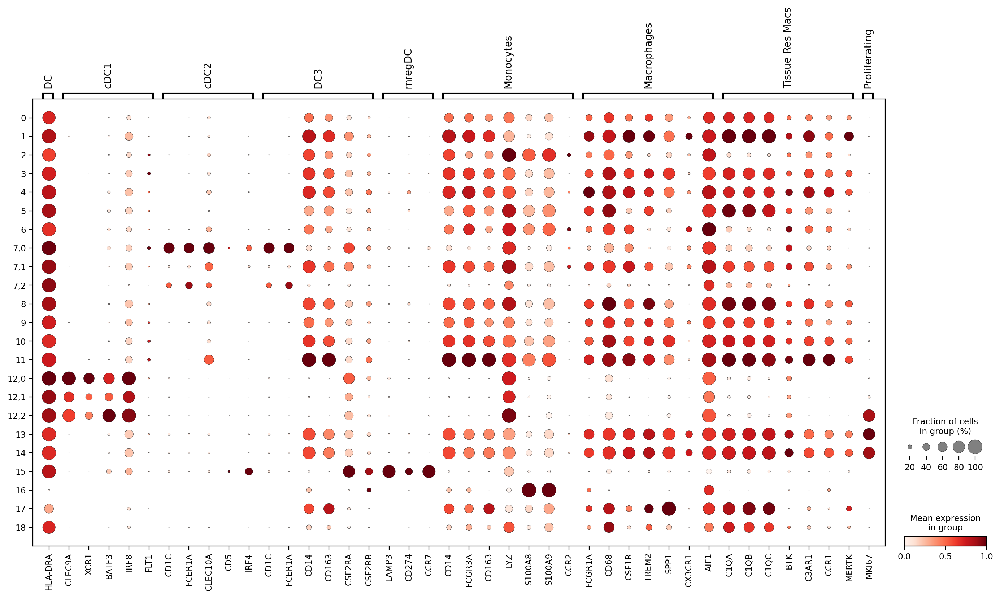

In [72]:
sc.pl.dotplot(data, myeloid_genes, groupby="clean-subcluster-v2", standard_scale="var")

In [75]:
broad_markers = ["HLA-DRA", "CLEC9A", "XCR1","BATF3","IRF8","FLT1", "CD1C", "FCER1A", "CLEC10A","CD5","IRF4", "CD14","CD163","CSF2RA","CSF2RB", "LAMP3","CD274","CCR7", "IRF7", "FCGR3A", "LYZ","S100A8","S100A9",
                 "CCR2", "FCGR1A", "CD68","CSF1R","TREM2","SPP1","CX3CR1","AIF1","C1QA","C1QB","C1QC","BTK","C3AR1","CCR1","MERTK","MKI67"]

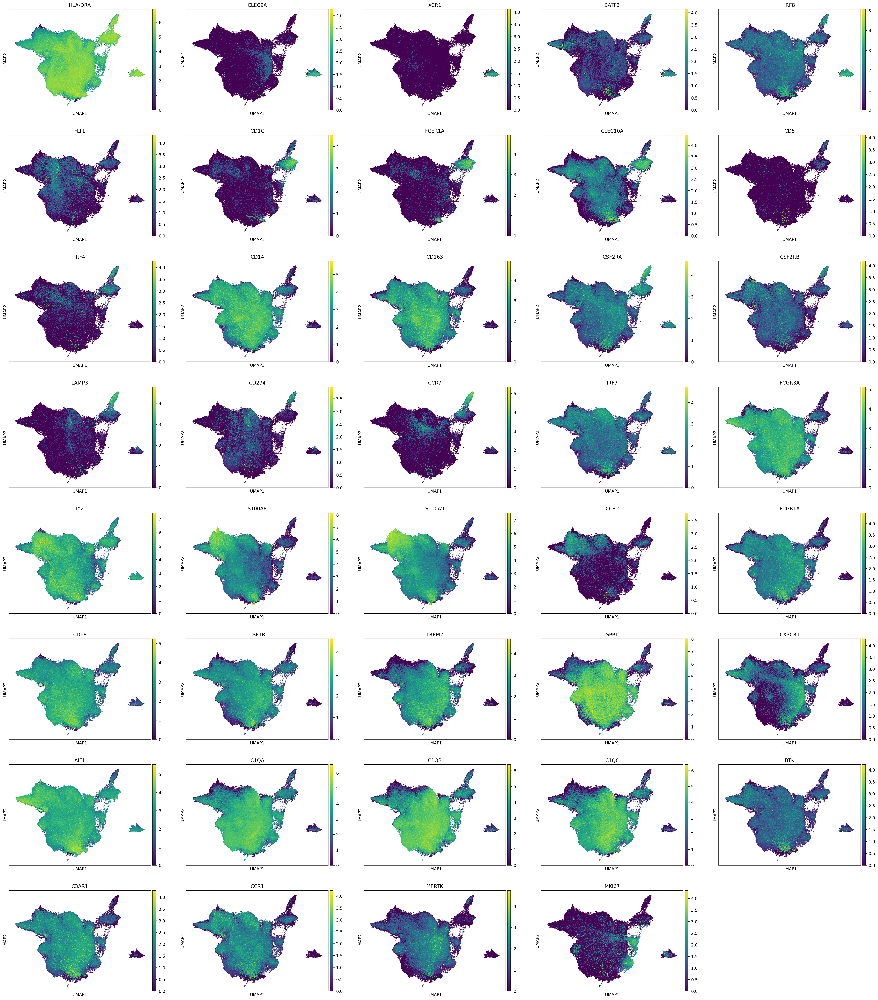

In [76]:
#plot DC/mono/mac marker genes on UMAP 
sc.pl.umap(
    data,
    color=broad_markers,
    ncols=5,
    size=5,
)

# Find DEG genes for each cluster (12min):

In [7]:
#calculate DEG genes:
sc.tl.rank_genes_groups(data, groupby="clean-subcluster-v2", method="wilcoxon")

/home/s4436039/miniforge3/envs/env/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:435: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
/home/s4436039/miniforge3/envs/env/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:437: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
/home/s4436039/miniforge3/envs/env/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:440: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor p

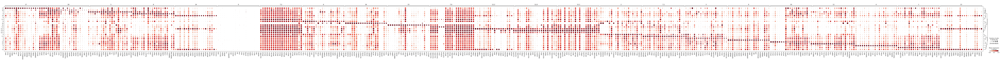

In [8]:
#visualise the top 20 DEG genes for each cluster
sc.pl.rank_genes_groups_dotplot(
    data, groupby="clean-subcluster-v2", standard_scale="var", n_genes=20, min_logfoldchange=1
)

In [7]:
cluster_2_6_16 = data[data.obs["clean-subcluster-v2"].isin(["2", "6","16"])]

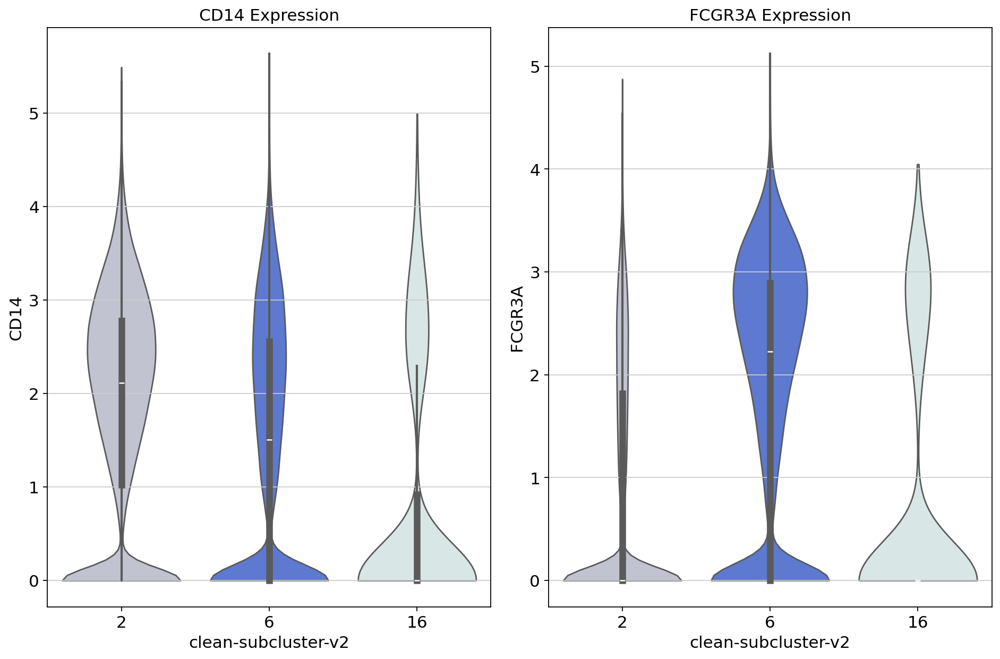

In [8]:
# Create a figure with two subplots side by side
fig, axes = plt.subplots(1, 2, figsize=(12, 8))

# Plot the first violin plot on the first axis
with plt.rc_context({"figure.figsize": (5, 8)}):
    sc.pl.violin(cluster_2_6_16, ["CD14"], 
                 groupby="clean-subcluster-v2",
                 stripplot=False,
                 inner="box",
                 ax=axes[0],
                 show=False)  # Disable immediate display

# Plot the second violin plot on the second axis
with plt.rc_context({"figure.figsize": (5, 8)}):
    sc.pl.violin(cluster_2_6_16, ["FCGR3A"], 
                 groupby="clean-subcluster-v2",
                 stripplot=False,
                 inner="box",
                 ax=axes[1],
                 show=False)  # Disable immediate display

# Add titles if desired
axes[0].set_title("CD14 Expression")
axes[1].set_title("FCGR3A Expression")

# Adjust layout to avoid overlap
plt.tight_layout()
plt.show()

# Checking if cluster 16 expresses FCGR3B (neutrophil marker)
* it does so excluding from plot

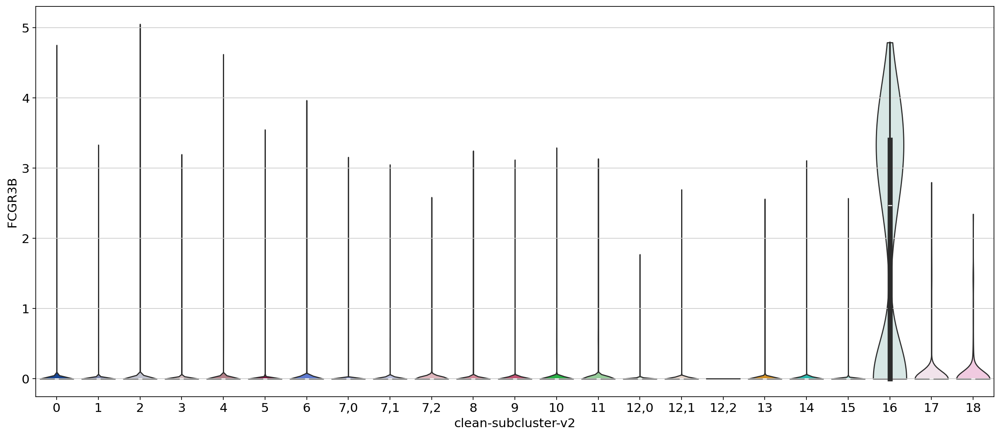

In [12]:
# Plot the first violin plot on the first axis
with plt.rc_context({"figure.figsize": (15, 8)}):
    sc.pl.violin(data, ["FCGR3B"], 
                 groupby="clean-subcluster-v2",
                 stripplot=False,
                 inner="box",
                 )  

## Removing neutrophils ***
* Want to remove neutrophils from my clean data (data here, NRclean_clustered)
* So that not lost for good, import pre-hvg object that has all cells (NRdata_pre-hvg.h5ad), copy across new leiden (clean-subcluster-v2), update keep_or_remove metadata for neutrophils to remove, update exclude_annots to "neutrophil-late remove"
* remove from clean data

In [7]:
print(data.obs.columns)

Index(['nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type',
       'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major',
       'cancer_subtype', 'integration_id', 'ident', 'dataset_id',
       'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts',
       'log1p_total_counts', 'pct_counts_in_top_50_genes',
       'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes',
       'pct_counts_in_top_500_genes', 'total_counts_mt',
       'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score',
       'keep_or_remove', 'leiden', 'celltype', 'leiden_DC', 'leiden_DC_v2',
       'exclude_annots', 'leiden_M', 'Technology', 'cancer_type_broad',
       'clean-leiden_0.8', 'clean-subcluster', 'clean-subcluster-v2', 'YS_sig',
       'HSC_sig', 'CD5nDC2_up_vDC3', 'DC3_up_vCD5nDC2', 'CD5pDC2_up_vDC3',
       'DC3_up_vCD5pDC2', 'DC3_up_vMono', 'Mono_up_vDC3', 'DC1_sig', 'DC2_sig',
       'DC3_sig', 'DC_Axl_sig', 'DC2_up_DC3', 'DC3_up_DC2', 'mregDC_sig',
    

In [8]:
# check how many keep vs remove
keep_counts = data.obs['keep_or_remove'].value_counts()
print(keep_counts)

keep_or_remove
keep    498382
Name: count, dtype: int64


In [ ]:
# read in pre-hvg data
pre_hvg = sc.read_h5ad('NRdata_pre-hvg.h5ad')

In [14]:
print(pre_hvg.obs.columns)

Index(['nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type',
       'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major',
       'cancer_subtype', 'integration_id', 'ident', 'dataset_id',
       'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts',
       'log1p_total_counts', 'pct_counts_in_top_50_genes',
       'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes',
       'pct_counts_in_top_500_genes', 'total_counts_mt',
       'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score',
       'keep_or_remove', 'leiden', 'celltype', 'leiden_DC', 'leiden_DC_v2',
       'exclude_annots', 'leiden_M', 'clean-subcluster-v2'],
      dtype='object')


In [10]:
#transfer new clustering to pre-hvg data
pre_hvg.obs["clean-subcluster-v2"] = data.obs["clean-subcluster-v2"]

In [11]:
#make a copy of pre_hvg containing just those in cluster 16
remove_16 = pre_hvg[pre_hvg.obs["clean-subcluster-v2"].isin(["16"])]

In [12]:
remove_16

View of AnnData object with n_obs × n_vars = 359 × 15074
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden', 'celltype', 'leiden_DC', 'leiden_DC_v2', 'exclude_annots', 'leiden_M', 'clean-subcluster-v2'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [15]:
#set all those in remove_16 'keep_or_remove' to remove, and 'exclude_annots' to 'neutrophil-late removal'
remove_16.obs["keep_or_remove"] = "remove"
remove_16.obs["exclude_annots"] = "neutrophil-late removal"

/scratch/temp/11565298/ipykernel_577766/1590194332.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


In [16]:
# check how many keep vs remove
keep_counts = pre_hvg.obs['keep_or_remove'].value_counts()
print(keep_counts)

keep_or_remove
keep      498382
remove    125526
Name: count, dtype: int64


In [17]:
# check exclude_annots
keep_counts = pre_hvg.obs['exclude_annots'].value_counts()
print(keep_counts)

exclude_annots
NA                         594446
ambig_mac                   16089
contaminants-exclude         5656
ambig_mono                   4026
fibroblasts-exclude          2358
contaminants                  661
ambig_Mt-mac                  281
GBM_specific-Mac-keep         234
NSCLC_specific-Mac-keep       157
Name: count, dtype: int64


In [19]:
#update the pre_hvg object to have correct keep vs remove labels and exclude annots 
pre_hvg.obs["keep_or_remove"].update(remove_16.obs["keep_or_remove"]) 

In [20]:
# check how many keep vs remove
keep_counts = pre_hvg.obs['keep_or_remove'].value_counts()
print(keep_counts)

keep_or_remove
keep      498023
remove    125885
Name: count, dtype: int64


In [22]:
#update the pre_hvg object to have correct keep vs remove labels and exclude annots 
pre_hvg.obs["exclude_annots"] = pre_hvg.obs["exclude_annots"].astype(str)
pre_hvg.obs["exclude_annots"].update(remove_16.obs["exclude_annots"]) 

/scratch/temp/11565298/ipykernel_577766/4023432594.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.




In [23]:
# check exclude_annots
keep_counts = pre_hvg.obs['exclude_annots'].value_counts()
print(keep_counts)

exclude_annots
NA                         594087
ambig_mac                   16089
contaminants-exclude         5656
ambig_mono                   4026
fibroblasts-exclude          2358
contaminants                  661
neutrophil-late removal       359
ambig_Mt-mac                  281
GBM_specific-Mac-keep         234
NSCLC_specific-Mac-keep       157
Name: count, dtype: int64


In [24]:
#re-save pre-hvg
pre_hvg.write_h5ad("NRdata_pre-hvg.h5ad", compression="gzip")

In [25]:
#remove cluster 16 from data
data_2 = data[~data.obs["clean-subcluster-v2"].isin(["16"])]

In [26]:
data_2

View of AnnData object with n_obs × n_vars = 498023 × 1268
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden', 'celltype', 'leiden_DC', 'leiden_DC_v2', 'exclude_annots', 'leiden_M', 'Technology', 'cancer_type_broad', 'clean-leiden_0.8', 'clean-subcluster', 'clean-subcluster-v2', 'YS_sig', 'HSC_sig', 'CD5nDC2_up_vDC3', 'DC3_up_vCD5nDC2', 'CD5pDC2_up_vDC3', 'DC3_up_vCD5pDC2', 'DC3_up_vMono', 'Mono_up_vDC3', 'DC1_sig', 'DC2_sig', 'DC3_sig', 'DC_Axl_sig', 'DC2_up_DC3', 'DC3_up_DC2', 'mregDC_sig', 'cDC1_mregDC', 'cDC2_mregDC'
    v

In [27]:
data

AnnData object with n_obs × n_vars = 498382 × 1268
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden', 'celltype', 'leiden_DC', 'leiden_DC_v2', 'exclude_annots', 'leiden_M', 'Technology', 'cancer_type_broad', 'clean-leiden_0.8', 'clean-subcluster', 'clean-subcluster-v2', 'YS_sig', 'HSC_sig', 'CD5nDC2_up_vDC3', 'DC3_up_vCD5nDC2', 'CD5pDC2_up_vDC3', 'DC3_up_vCD5pDC2', 'DC3_up_vMono', 'Mono_up_vDC3', 'DC1_sig', 'DC2_sig', 'DC3_sig', 'DC_Axl_sig', 'DC2_up_DC3', 'DC3_up_DC2', 'mregDC_sig', 'cDC1_mregDC', 'cDC2_mregDC'
    var: 'nam

In [28]:
#save object
data_2.write_h5ad("NRclean_clustered.h5ad", compression="gzip")

# Define Annotations:

In [6]:
# read in data
data = sc.read_h5ad('NRclean_clustered.h5ad')

In [7]:
# check annots
annots = data.obs['clean-subcluster-v2'].value_counts()
print(annots)

clean-subcluster-v2
0       85307
1       67085
2       57086
3       55287
4       44122
5       39558
6       29255
8       21362
9       20317
7,0     16432
10      15628
11      11130
7,1      8264
13       6564
14       6456
15       6120
12,0     4091
12,1     2423
7,2       959
12,2      216
17        205
18        156
Name: count, dtype: int64


In [8]:
data.obs["NR_annotations"] = data.obs["clean-subcluster-v2"].map(
    {
        "0": "Tissue resident macrophage",
        "1": "CX3CR1+ Tissue resident macrophage",
        "2": "Classical monocytes",
        "3": "Tissue resident macrophage",
        "4": "Tissue resident macrophage",
        "5": "Tissue resident macrophage",
        "6": "non-classical monocytes",
        "7,0": "cDC2",
        "7,1": "Tissue resident macrophage",
        "7,2": "cDC2",
        "8": "Tissue resident macrophage",
        "9": "Heat-shock macrophage",
        "10": "Tissue resident macrophage",
        "11": "CD14+ CD163+ macrophage",
        "12,0": "cDC1",
        "12,1": "cDC1",
        "12,2": "cDC1",
        "13": "KI-67+ macrophage",
        "14": "KI-67+ macrophage",
        "15": "mregDC",
        "17": "Tissue resident macrophage",
        "18": "Tissue resident macrophage"
    }
)

In [9]:
# check annots
annots = data.obs['NR_annotations'].value_counts()
print(annots)

NR_annotations
Tissue resident macrophage            269889
CX3CR1+ Tissue resident macrophage     67085
Classical monocytes                    57086
non-classical monocytes                29255
Heat-shock macrophage                  20317
cDC2                                   17391
KI-67+ macrophage                      13020
CD14+ CD163+ macrophage                11130
cDC1                                    6730
mregDC                                  6120
Name: count, dtype: int64


In [10]:
#save object
data.write_h5ad("NRclean_clustered.h5ad", compression="gzip")

# visualisation continues in notebook: 2024-11-15_Visualising-clean.jpynb